<a href="https://colab.research.google.com/github/momijizen/Coursera_Capstone/blob/main/Report_Capstone_Bangkok.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Clustering district in Bangkok, Thailand

---





#Table of Contents
1. Introduction
  - Background
  - Business Problem
  - Interest
2. Data
  - Population data 
  - Shape area data 
  - Location data
  - Foursquare API
3. Methodology
  
4. Result 
5. Discussion
5. Conclusion

#1. Introduction

##Background

Bangkok is the capital and most populous city of Thailand. It is known in Thai as Krung Thep Maha Nakhon or simply Krung Thep. The city occupies 1,568.7 square kilometers (605.7 sq mi) in the Chao Phraya River delta in central Thailand and has an estimated population of 10.539 million as of 2020, 15.3 percent of the country's population. Over fourteen million people (22.2 percent) lived within the surrounding Bangkok Metropolitan Region at the 2010 census, making Bangkok an extremely primate city, dwarfing Thailand's other urban centers in both size and importance to the national economy.

##Business Problem
How to find a suitable restaurant business location in Bangkok?

From the information, Bangkok is the city with the highest population density in Thailand. There are many buildings and meeting places. Therefore, it is interesting for investors to build a business, specifically a restaurant business. But it is difficult to find the suitable place for the restaurant location. The problem with stakeholders is finding a place with less restaurant density and high population density. Therefore, in this project, we will use data science methods to analyze the data to display the results for stakeholders to consider as part of business decision-making.

##Interest
Investors interested in investing, and stakeholders will be interested in this project. And take this as part of your investment consideration. Once we have analyzed the existing data and solved these problems with machine learning methods. Then create a map and visualized group each district of population density and restaurants density.

#2. Data

The data I use includes:

* **population data** - I discover population data of each district in Bangkok from 
the Thailand Digital Government Development Agency (DGA), which this uses for calculating population density.

* **Bangkok boundary coordinates** - I searched for a Bangkok boundary file or a GeoJson file to create a choropleth map. However, I discovered a Thailand administrative region - sub from data.humdata.org as a shapefile (.shp) containing the coordinates of all cities of Thailand. So I selected only the properties that I required, which were Bangkok's coordinates, and save it as a GeoJson file to reduce the file size and flexibility in working.

* **sub-district location coordinates** - I use the Bangkok dataset from the Thailand Digital Government Development Agency (DGA), which contains the longitude and latitude coordinates for each sub-district in Bangkok.

* **Forsquare API** - I used Forsquare API to get the restaurant's neighborhood given coordinates center point for each sub-district of Bangkok.


I will divide the data into two parts. The first part uses population data and Bangkok boundary coordinates to calculate the population density. The second part uses the district location coordinates as input to the Forsquare API to find restaurants within a radius of 500 meters from the location coordinates.

#3. Methodology

##Import libraries

In [1]:
import numpy as np
import pandas as pd
import requests
import json
import seaborn as sns

# use the inline backend to generate the plots within the browser
%matplotlib inline 
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.style.use('ggplot') # optional: for ggplot-like style

from matplotlib.patches import Patch

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.datasets import make_blobs

from sklearn import preprocessing

!pip install -q geopy
from geopy.geocoders import Nominatim # module to convert an address into latitude and longitude values

# libraries for displaying images
from IPython.display import Image 
from IPython.core.display import HTML 
    
# tranforming json file into a pandas dataframe library
from pandas.io.json import json_normalize

#!pip install -q folium==0.5.0
import folium # plotting library

!pip install -q django  
from django.contrib.gis.geos import Polygon # convert an UTM coordinates into latitude and longitude values
from pprint import pprint

     |████████████████████████████████| 7.9MB 5.4MB/s 


In [2]:
#that extends the datatypes used by pandas to allow spatial operations on geometric types
!pip install -q geopandas
import geopandas as gpd 
#an utility module to deal with colormaps
import branca.colormap as cm

     |████████████████████████████████| 1.0MB 5.3MB/s 
     |████████████████████████████████| 15.4MB 185kB/s 
     |████████████████████████████████| 6.6MB 37.7MB/s 


In [3]:
#add font thai
#import matplotlib.font_manager as fm
#font_list = fm.createFontList(['THSarabunNew.ttf'])
#fm.fontManager.ttflist.extend(font_list)
# set font
#plt.rcParams['font.family'] = 'TH Sarabun New'
#plt.rcParams['xtick.labelsize'] = 20.0
#plt.rcParams['ytick.labelsize'] = 20.0

##Location Data

In [4]:
url = "https://raw.githubusercontent.com/momijizen/Coursera_Capstone/main/sub_district_location_22.csv"
df_province = pd.read_csv(url)
df_province.head()

,TA_ID,TAMBON_E,TAMBON_T,AMPHOE_E,AMPHOE_T,AM_ID,CH_ID,CHANGWAT_T,CHANGWAT_E,LAT,LONG,geometry
0,100101,Phraborom Maharatchawang,พระบรมมหาราชวัง,Phra Nakhon,พระนคร,1001,10,กรุงเทพมหานคร,Bangkok,13.751,100.492,"POLYGON ((100.4945250630001 13.75759217300003,..."
1,100102,Wang Burapha Phirom,วังบูรพาภิรมย์,Phra Nakhon,พระนคร,1001,10,กรุงเทพมหานคร,Bangkok,13.744,100.499,"POLYGON ((100.5013079340001 13.74800340100006,..."
2,100103,Wat Ratchabophit,วัดราชบพิธ,Phra Nakhon,พระนคร,1001,10,กรุงเทพมหานคร,Bangkok,13.750,100.499,"POLYGON ((100.5014023240001 13.74817006900003,..."
3,100104,Samran Rat,สำราญราษฎร์,Phra Nakhon,พระนคร,1001,10,กรุงเทพมหานคร,Bangkok,13.751,100.503,"POLYGON ((100.505542888 13.75378260200006, 100..."
4,100105,San Chaopho Suea,ศาลเจ้าพ่อเสือ,Phra Nakhon,พระนคร,1001,10,กรุงเทพมหานคร,Bangkok,13.754,100.497,"POLYGON ((100.498745216 13.75560216800005, 100..."


In [5]:
#select only Bangkok city
df_province = df_province[df_province['CHANGWAT_E'] == 'Bangkok']
df_province.reset_index(drop=True,inplace=True)

In [6]:
#select columns
df_province = df_province[['TA_ID','TAMBON_T','TAMBON_E','AM_ID','AMPHOE_T','AMPHOE_E','LAT','LONG']]
#rename columns
df_province.columns = ['sub_district_id','sub_district_th', 'sub_district_eng','district_id','district_th','district_eng','latitude','longitude']

In [7]:
df_province = df_province.astype({'sub_district_id':str,'district_id':str})
df_province.head()

,sub_district_id,sub_district_th,sub_district_eng,district_id,district_th,district_eng,latitude,longitude
0,100101,พระบรมมหาราชวัง,Phraborom Maharatchawang,1001,พระนคร,Phra Nakhon,13.751,100.492
1,100102,วังบูรพาภิรมย์,Wang Burapha Phirom,1001,พระนคร,Phra Nakhon,13.744,100.499
2,100103,วัดราชบพิธ,Wat Ratchabophit,1001,พระนคร,Phra Nakhon,13.750,100.499
3,100104,สำราญราษฎร์,Samran Rat,1001,พระนคร,Phra Nakhon,13.751,100.503
4,100105,ศาลเจ้าพ่อเสือ,San Chaopho Suea,1001,พระนคร,Phra Nakhon,13.754,100.497


##Population Data

In [8]:
path = "https://raw.githubusercontent.com/momijizen/Coursera_Capstone/main/population.csv"
df_population = pd.read_csv(path)
df_population.head()

,dcode,population48,population49,population50,population51,population52,population53,population54,population55,population56,population57,population58,population59,population60,population61
0,1001,67357,65835,64356,62966,61374,60313,58771,57831,56684,55373,54195,52522,0,50382
1,1002,121336,119927,117867,116742,114488,111496,108815,107969,106811,104394,103230,98450,0,94854
2,1003,126126,133415,138667,143675,147668,151292,154371,157224,159962,162598,164494,167844,0,172990
3,1004,50023,49730,49124,48506,47503,47053,46087,46112,46114,46472,46606,47308,0,48207
4,1005,178986,181390,182335,183836,185901,188164,188252,189737,190544,190659,190528,190828,0,191323


In [9]:
#select only population while year 2018
df_district_population = df_population[['dcode','population61']]
df_district_population.columns = ['district_id','population']
df_district_population = df_district_population.astype({'district_id':str})
df_district_population.set_index('district_id', inplace=True)
df_district_population.head()

,population
district_id,
1001,50382
1002,94854
1003,172990
1004,48207
1005,191323


In [10]:
#group by district
df_district = df_province.groupby(by=['district_id','district_eng','district_th']).count().reset_index()
df_district = df_district[['district_id','district_eng','district_th']]
df_district.set_index('district_id', inplace=True)

In [11]:
#join district with population
df_district_population = df_district_population.merge(df_district, how='inner',left_index=True, right_index=True).reset_index()
df_district_population.head()

,district_id,population,district_eng,district_th
0,1001,50382,Phra Nakhon,พระนคร
1,1002,94854,Dusit,ดุสิต
2,1003,172990,Nong Chok,หนองจอก
3,1004,48207,Bang Rak,บางรัก
4,1005,191323,Bang Khen,บางเขน


##Boundary Coordinates Data

####Create GeoJSON file

Unzip Thailand administrative boundary shapefiles

In [ ]:
import zipfile as zf
files = zf.ZipFile("th_borough.zip", 'r')
files.extractall('directory to extract')
files.close()

using geopandas libraries for reading shapefiles to dataframe format.

In [ ]:
#read shapefile
#fname = 'th_borough/tha_admbnda_adm2_rtsd_20190221.shp'
fname = 'tha_admbnda_adm3_rtsd_20190221.shp'
tha = gpd.read_file(fname)
#tha.crs = "epsg:4326"
tha.head()

In [ ]:
# select only Bangkok shape
bangkok = tha[tha['ADM1_EN'] == 'Bangkok']
# select columns
bangkok = bangkok[['Shape_Leng','Shape_Area','ADM3_PCODE', 'ADM3_EN','ADM3_TH', 'geometry']]

In [ ]:
# slice 'TH' out from PCODE columns
bangkok['ADM3_PCODE'] = bangkok['ADM3_PCODE'].str.slice(2,)

In [ ]:
bangkok.reset_index(drop=True, inplace=True)
bangkok.head()

Save it as a geojson file for a new runtime in future that will reduce step and time loading extensive file.

In [ ]:
#save bangkok geojson file
bangkok.to_file("bangkok_district.geojson", driver='GeoJSON')

####Load GeoJSON files

bangkok district

In [12]:
#!wget -q 'https://raw.githubusercontent.com/momijizen/Coursera_Capstone/main/bangkok_district.geojson'
#bkk2 = json.load(open('bangkok_district.geojson'), encoding='utf-8') 
#df = json_normalize(bkk2["features"])

In [12]:
district_geojson_path = 'https://raw.githubusercontent.com/momijizen/Coursera_Capstone/main/bangkok_district.geojson'
district_geojson = gpd.read_file(district_geojson_path)
district_geojson.head()

,Shape_Leng,Shape_Area,ADM2_PCODE,ADM2_EN,ADM2_TH,geometry
0,0.280742,0.002845,1050,Bang Bon,บางบอน,"POLYGON ((100.44566 13.68409, 100.44570 13.684..."
1,0.308691,0.002303,1006,Bang Kapi,บางกะปิ,"POLYGON ((100.62906 13.81937, 100.62910 13.819..."
2,0.269957,0.003998,1040,Bang Khae,บางแค,"POLYGON ((100.36609 13.75391, 100.36702 13.753..."
3,0.301722,0.003415,1005,Bang Khen,บางเขน,"POLYGON ((100.60999 13.89078, 100.60997 13.890..."
4,0.116813,0.000715,1031,Bang Kho Laem,บางคอแหลม,"POLYGON ((100.51966 13.70323, 100.51968 13.703..."


bangkok sub-district

In [13]:
sub_district_geojson_path = 'https://raw.githubusercontent.com/momijizen/Coursera_Capstone/main/bangkok_sub_district.geojson'
sub_district_geojson = gpd.read_file(sub_district_geojson_path)
sub_district_geojson.head()

,ADM3_PCODE,ADM3_EN,ADM3_TH,ADM2_PCODE,ADM2_EN,ADM2_TH,geometry
0,100502,Anusawari,อนุสาวรีย์,1005,Bang Khen,บางเขน,"POLYGON ((100.60997 13.89074, 100.60994 13.890..."
1,102009,Arun Ammarin,อรุณอมรินทร์,1020,Bangkok Noi,บางกอกน้อย,"POLYGON ((100.46835 13.78752, 100.46870 13.787..."
2,100804,Ban Bat,บ้านบาตร,1008,Pom Prap Sattru Phai,ป้อมปราบศัตรูพ่า,"POLYGON ((100.50966 13.75645, 100.50955 13.755..."
3,102005,Ban Chang Lo,บ้านช่างหล่อ,1020,Bangkok Noi,บางกอกน้อย,"POLYGON ((100.47796 13.75630, 100.47799 13.755..."
4,100110,Ban Phan Thom,บ้านพานถม,1001,Phra Nakhon,พระนคร,"POLYGON ((100.50767 13.75995, 100.50699 13.758..."


##Calculate Population Density

Make sure the AMD2_pcode is matching with the district id in df_district_population .

In [14]:
geo_district = district_geojson['ADM2_PCODE'].tolist()
district_id = df_district_population['district_id'].tolist()

In [15]:
print(list(set(district_id) - set(geo_district)))
print(list(set(geo_district) - set(district_id)))

[]
[]


Join shape area with population district

In [16]:
df =  district_geojson[['Shape_Area','ADM2_PCODE']]
df.columns = ['shape_area','district_id']
df = df.astype({'district_id':str})
df.head()

,shape_area,district_id
0,0.002845,1050
1,0.002303,1006
2,0.003998,1040
3,0.003415,1005
4,0.000715,1031


In [17]:
df_district_population = df_district_population.merge(df,on=['district_id','district_id'])
df_district_population.head()

,district_id,population,district_eng,district_th,shape_area
0,1001,50382,Phra Nakhon,พระนคร,0.000450
1,1002,94854,Dusit,ดุสิต,0.000950
2,1003,172990,Nong Chok,หนองจอก,0.019859
3,1004,48207,Bang Rak,บางรัก,0.000337
4,1005,191323,Bang Khen,บางเขน,0.003415


Convert square kilometers to square meters and calculate people per square meter.

In [18]:
df_district_population['pop_density'] = df_district_population['population'] / (df_district_population['shape_area'] * 1e+6) #1000000
df_district_population.head()

,district_id,population,district_eng,district_th,shape_area,pop_density
0,1001,50382,Phra Nakhon,พระนคร,0.000450,111.843548
1,1002,94854,Dusit,ดุสิต,0.000950,99.826204
2,1003,172990,Nong Chok,หนองจอก,0.019859,8.710972
3,1004,48207,Bang Rak,บางรัก,0.000337,143.066109
4,1005,191323,Bang Khen,บางเขน,0.003415,56.025456


Merge `pop_density` conlumn to `df_province` dataframe

In [19]:
df_province = df_province.merge(df_district_population[['district_id','pop_density']],on='district_id',how='left')

Merge `pop_density` conlumn to `sub_district_geojson` geodataframe

In [20]:
sub_district_geojson.columns = ['sub_district_id','sub_district_eng', 'sub_district_th','district_id','district_eng','district_th','geometry']

In [21]:
sub_district_geojson = sub_district_geojson.merge(df_district_population[['district_id','pop_density']],left_on='district_id',right_on='district_id',how='left')


##Foursquare API

Define Foursquare Credentials and Version

In [22]:
CLIENT_ID = 'M1QUR2OTW2YEYMXNYIF3AOIRNPCTUXFGQQCXAV3HGOTXEAO4' # your Foursquare ID
CLIENT_SECRET = 'XRK0T0KEG1UDGCU5YEGXMXR3QIRU02JZY3QOBN0BYLNPS52N' # your Foursquare Secret
ACCESS_TOKEN = '1KDLE0AX2IH4RBQL5P41P0IW4TFKATXNH5TO1VZPVUCIKN3Q' # your FourSquare Access Token
VERSION = '20180604'
LIMIT = 500
search_query = 'restaurant'
radius = 500
print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: M1QUR2OTW2YEYMXNYIF3AOIRNPCTUXFGQQCXAV3HGOTXEAO4
CLIENT_SECRET:XRK0T0KEG1UDGCU5YEGXMXR3QIRU02JZY3QOBN0BYLNPS52N


Create a function to find the venues of all district neighborhoods.

In [23]:
def getNearbyVenues(sub_district_id,district_id, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for sub_district_id,district_id, lat, lng in zip(sub_district_id,district_id, latitudes, longitudes):
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            sub_district_id,
            district_id, 
            lat, 
            lng, 
            v['venue']['id'],
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],
            v['venue']['location']['distance'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['sub_district_id','district_id', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude',
                  'Id',
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude',
                  'Venue Distance', 
                  'Venue Category']
    
    return(nearby_venues)

In [24]:
df_venues = getNearbyVenues(sub_district_id=df_province['sub_district_id'],
                         district_id= df_province['district_id'],
                         latitudes= df_province['latitude'], 
                         longitudes= df_province['longitude']
                         )

In [25]:
df_venues_new = df_venues
print(df_venues.shape)
df_venues.head(10)

(2864, 10)


,sub_district_id,district_id,Neighborhood Latitude,Neighborhood Longitude,Id,Venue,Venue Latitude,Venue Longitude,Venue Distance,Venue Category
0,100101,1001,13.751,100.492,4e3105c381302aa582e214a7,Dusit Maha Prasat Throne Hall (พระที่นั่งดุสิต...,13.750105,100.490524,188,Palace
1,100101,1001,13.751,100.492,4cddfc11f8cdb1f718578812,Chakri Maha Prasat Throne Hall (พระที่นั่งจักร...,13.750063,100.491290,129,Palace
2,100101,1001,13.751,100.492,4b0587f9f964a52001aa22e3,Temple of the Emerald Buddha (วัดพระศรีรัตนศาส...,13.751735,100.492651,107,Buddhist Temple
3,100101,1001,13.751,100.492,4ceb69b1d27560fca3439b3a,The Grand Palace (พระบรมมหาราชวัง),13.751814,100.491176,127,Palace
4,100101,1001,13.751,100.492,50fe0e2be4b0687cec3a9c22,Wat Phra Keo Museum,13.750632,100.490154,203,Temple
5,100101,1001,13.751,100.492,4c5d1c69857ca593fa11cccb,7-Eleven,13.752414,100.492148,158,Convenience Store
6,100101,1001,13.751,100.492,4d9bdddd7ae5548198a34174,Prasat Phra Thep Bidon (ปราสาทพระเทพบิดร),13.751606,100.492720,103,Palace
7,100101,1001,13.751,100.492,4f4efe70e4b0e52480c1837f,Cafe' Palazzo,13.752409,100.490931,194,Café
8,100101,1001,13.751,100.492,4c3965ed2c8020a184b98c00,อาคุงเต้าฮวยโบราณ,13.752773,100.489456,338,Dessert Shop
9,100101,1001,13.751,100.492,5493fcff498ecc2164b93e85,Favour Café,13.754418,100.489017,498,Café


###Drop Duplicated in Venues column

In [26]:
df_venues = df_venues.sort_values(by='Venue Distance').drop_duplicates(subset=['Id'],keep='first' )
df_venues.shape

(2472, 10)

###Select Restaurant categories

In [27]:
df_restaurant = df_venues[df_venues['Venue Category'].str.lower().str.contains('restaurant')].reset_index(drop=True)
df_restaurant.shape

(735, 10)

Displays the name of the restaurant category.

In [28]:
category_restaurant = df_restaurant.groupby(by='Venue Category')['Venue Category'].count().reset_index(name='count').sort_values(by='count', ascending=False)
print(category_restaurant.shape)
category_restaurant

(47, 2)


,Venue Category,count
41,Thai Restaurant,198
1,Asian Restaurant,79
19,Japanese Restaurant,67
4,Chinese Restaurant,59
31,Restaurant,41
36,Som Tum Restaurant,41
9,Fast Food Restaurant,34
33,Seafood Restaurant,23
38,Sushi Restaurant,20
14,Hotpot Restaurant,17


Text(0.5, 1.0, 'Number of Restaurant Category')

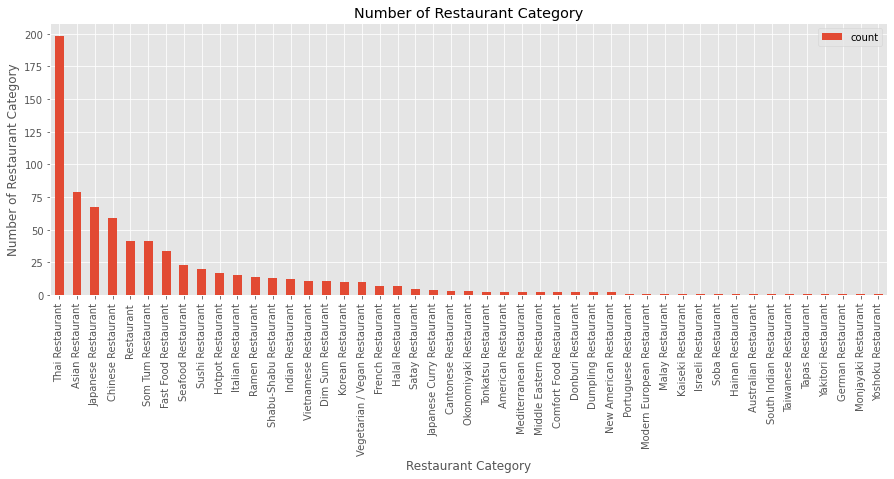

In [29]:
category_restaurant.sort_values(by='count',ascending=False)[:].plot(
    kind='bar',x='Venue Category',y='count',figsize=(15,5))
#plt.xticks(rotation=70)
plt.ylabel('Number of Restaurant Category')
plt.xlabel('Restaurant Category')
plt.title('Number of Restaurant Category')

##Calculate Restaurant Density

In [30]:
restaurant_group = df_restaurant.groupby(by='sub_district_id')['Venue Category'].count().reset_index(name='restaurant_count').sort_values(by='restaurant_count', ascending=False)
restaurant_group.head()

,sub_district_id,restaurant_count
100,103302,40
114,103902,39
18,100403,31
20,100405,28
92,103005,23


Divide with area of a circle, radius = 500 meter

In [31]:
restaurant_group['rest_density'] = restaurant_group['restaurant_count'] / (np.pi * 500 * 500)
restaurant_group.head()

,sub_district_id,restaurant_count,rest_density
100,103302,40,0.000051
114,103902,39,0.000050
18,100403,31,0.000039
20,100405,28,0.000036
92,103005,23,0.000029


In [32]:
df_province.shape

(169, 9)

In [33]:
df_province = df_province.merge(restaurant_group ,on='sub_district_id',how='left')
df_province

,sub_district_id,sub_district_th,sub_district_eng,district_id,district_th,district_eng,latitude,longitude,pop_density,restaurant_count,rest_density
0,100101,พระบรมมหาราชวัง,Phraborom Maharatchawang,1001,พระนคร,Phra Nakhon,13.751000,100.492000,111.843548,1.0,0.000001
1,100102,วังบูรพาภิรมย์,Wang Burapha Phirom,1001,พระนคร,Phra Nakhon,13.744000,100.499000,111.843548,6.0,0.000008
2,100103,วัดราชบพิธ,Wat Ratchabophit,1001,พระนคร,Phra Nakhon,13.750000,100.499000,111.843548,2.0,0.000003
3,100104,สำราญราษฎร์,Samran Rat,1001,พระนคร,Phra Nakhon,13.751000,100.503000,111.843548,1.0,0.000001
4,100105,ศาลเจ้าพ่อเสือ,San Chaopho Suea,1001,พระนคร,Phra Nakhon,13.754000,100.497000,111.843548,2.0,0.000003
...,...,...,...,...,...,...,...,...,...,...,...
164,103605,สนามบิน,Sanam Bin,1036,ดอนเมือง,Don Mueang,13.919270,100.604199,54.751515,4.0,0.000005
165,104302,รามอินทรา,Ram Inthra,1043,คันนายาว,Khan Na Yao,13.838919,100.661936,45.529439,2.0,0.000003
166,104502,สะพานสอง,Saphan Song,1045,วังทองหลาง,Wang Thonglang,13.797084,100.590611,77.939436,1.0,0.000001
167,104503,คลองเจ้าคุณสิงห์,Khlong Chaokhun Sing,1045,วังทองหลาง,Wang Thonglang,13.785047,100.622365,77.939436,NaN,NaN


In [34]:
df_province[['restaurant_count'	,'rest_density']] = df_province[['restaurant_count'	,'rest_density']].fillna(0)
df_province.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 169 entries, 0 to 168
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   sub_district_id   169 non-null    object 
 1   sub_district_th   169 non-null    object 
 2   sub_district_eng  169 non-null    object 
 3   district_id       169 non-null    object 
 4   district_th       169 non-null    object 
 5   district_eng      169 non-null    object 
 6   latitude          169 non-null    float64
 7   longitude         169 non-null    float64
 8   pop_density       169 non-null    float64
 9   restaurant_count  169 non-null    float64
 10  rest_density      169 non-null    float64
dtypes: float64(5), object(6)
memory usage: 15.8+ KB


Merge rest_density conlumn to sub_district_geojson geodataframe

In [35]:
sub_district_geojson = sub_district_geojson.merge(df_province[['sub_district_id','rest_density']],left_on='sub_district_id',right_on='sub_district_id',how='left')


##Analyze each sub-district

One-hot Dataframe

In [36]:
restaurant_onehot = pd.get_dummies(df_restaurant['Venue Category'])
restaurant_onehot['sub_district_id'] = df_restaurant['sub_district_id']

In [37]:
restaurant_group_mean = restaurant_onehot.groupby('sub_district_id').mean().reset_index()

the function to sort the restaurant in descending order.

In [38]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [40]:
num_top_venues = 1

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['sub_district_id']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Restaurant Category'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Restaurant Category'.format(ind+1))

# create a new dataframe
restaurant_most = pd.DataFrame(columns=columns)
restaurant_most['sub_district_id'] = restaurant_group_mean['sub_district_id']

for ind in np.arange(restaurant_group_mean.shape[0]):
    restaurant_most.iloc[ind, 1:] = return_most_common_venues(restaurant_group_mean.iloc[ind, :], num_top_venues)

restaurant_most

,sub_district_id,1st Most Restaurant Category
0,100101,Thai Restaurant
1,100102,Asian Restaurant
2,100103,Thai Restaurant
3,100104,Thai Restaurant
4,100105,Asian Restaurant
...,...,...
131,104701,Thai Restaurant
132,104801,Seafood Restaurant
133,104802,Thai Restaurant
134,104901,Thai Restaurant


merge `1st Most Restaurant Category` column to `df_province` dataframe

In [41]:
df_province = df_province.merge(restaurant_most,on='sub_district_id',how='left')
df_province.head()

,sub_district_id,sub_district_th,sub_district_eng,district_id,district_th,district_eng,latitude,longitude,pop_density,restaurant_count,rest_density,1st Most Restaurant Category
0,100101,พระบรมมหาราชวัง,Phraborom Maharatchawang,1001,พระนคร,Phra Nakhon,13.751,100.492,111.843548,1.0,0.000001,Thai Restaurant
1,100102,วังบูรพาภิรมย์,Wang Burapha Phirom,1001,พระนคร,Phra Nakhon,13.744,100.499,111.843548,6.0,0.000008,Asian Restaurant
2,100103,วัดราชบพิธ,Wat Ratchabophit,1001,พระนคร,Phra Nakhon,13.750,100.499,111.843548,2.0,0.000003,Thai Restaurant
3,100104,สำราญราษฎร์,Samran Rat,1001,พระนคร,Phra Nakhon,13.751,100.503,111.843548,1.0,0.000001,Thai Restaurant
4,100105,ศาลเจ้าพ่อเสือ,San Chaopho Suea,1001,พระนคร,Phra Nakhon,13.754,100.497,111.843548,2.0,0.000003,Asian Restaurant


In [42]:
df_province.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 169 entries, 0 to 168
Data columns (total 12 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   sub_district_id               169 non-null    object 
 1   sub_district_th               169 non-null    object 
 2   sub_district_eng              169 non-null    object 
 3   district_id                   169 non-null    object 
 4   district_th                   169 non-null    object 
 5   district_eng                  169 non-null    object 
 6   latitude                      169 non-null    float64
 7   longitude                     169 non-null    float64
 8   pop_density                   169 non-null    float64
 9   restaurant_count              169 non-null    float64
 10  rest_density                  169 non-null    float64
 11  1st Most Restaurant Category  136 non-null    object 
dtypes: float64(5), object(7)
memory usage: 17.2+ KB


##Visualize Data

###Figure 1: Histogram and Box Plots of population density

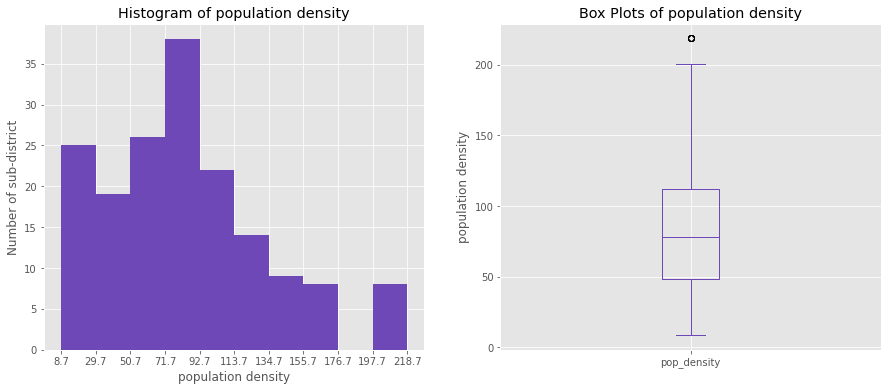

In [43]:
fig = plt.figure() # create figure

ax0 = fig.add_subplot(1, 2, 1) # add subplot 1 (1 row, 2 columns, first plot)
ax1 = fig.add_subplot(1, 2, 2) # add subplot 2 (1 row, 2 columns, second plot). See tip below**

# Subplot 1: Box plot
count, bin_edges = np.histogram(df_province['pop_density'])
df_province['pop_density'].plot(kind='hist',figsize=(15,6), color='#6D48B6',xticks=bin_edges,ax=ax0)# add to subplot 1
ax0.set_title('Histogram of population density')
ax0.set_ylabel('Number of sub-district')
ax0.set_xlabel('population density')

# Subplot 2: Line plot
df_province['pop_density'].plot(kind='box',figsize=(15,6), color='#6D48B6',ax=ax1)# add to subplot 2
ax1.set_title('Box Plots of population density')
ax1.set_ylabel('population density')
plt.show()

###Figure 2: Histogram and Box Plots of Restaurant density

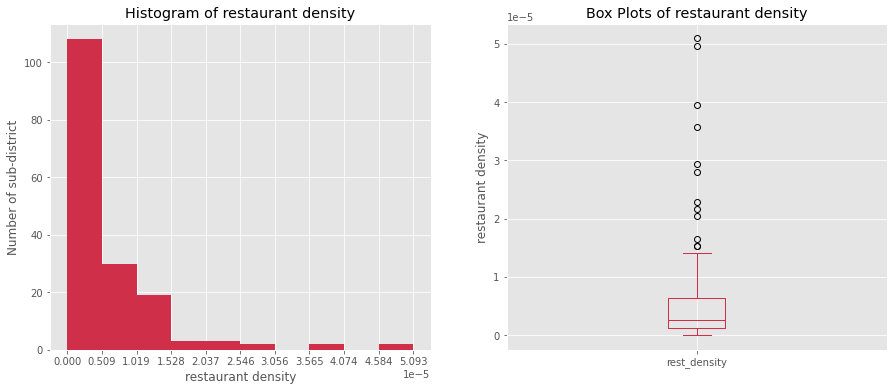

In [44]:
fig = plt.figure() # create figure

ax0 = fig.add_subplot(1, 2, 1) # add subplot 1 (1 row, 2 columns, first plot)
ax1 = fig.add_subplot(1, 2, 2) # add subplot 2 (1 row, 2 columns, second plot). See tip below**

# Subplot 1: Box plot
count, bin_edges = np.histogram(df_province['rest_density'])
df_province['rest_density'].plot(kind='hist',figsize=(15,6), color='#CF2F49',xticks=bin_edges,ax=ax0)# add to subplot 1
ax0.set_title('Histogram of restaurant density')
ax0.set_ylabel('Number of sub-district')
ax0.set_xlabel('restaurant density')

# Subplot 2: Line plot
df_province['rest_density'].plot(kind='box',figsize=(15,6), color='#CF2F49',ax=ax1)# add to subplot 2
ax1.set_title('Box Plots of restaurant density')
ax1.set_ylabel('restaurant density')
plt.show()

###Figure 3: Correlation between population density and restaurant density

Text(0.5, 67.99999999999994, 'restaurant density')

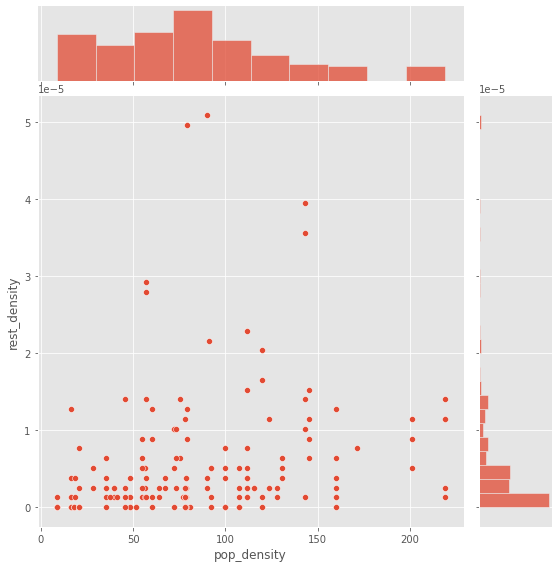

In [45]:
sns.jointplot(x='pop_density', y='rest_density',data=df_province , height=8) 
#plt.title('population density and restaurant density')
plt.ylabel('population density')
plt.xlabel('restaurant density')

##Visualize Data Map

###Population Density Choropleth Map

Use geopy library to get the latitude and longitude values of Bangkok City.

In [46]:
address = 'Bangkok, Thailand' 

geolocator = Nominatim(user_agent="foursquare_agent")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print(latitude, longitude)

13.7544238 100.4930399


In [47]:
bangkok_geo = sub_district_geojson #'bangkok_sub_district.geojson' # geojson file

# create a plain province map
bangkok_map = folium.Map(location=[latitude, longitude], zoom_start=10)

#use different map tiles (OpenStreetMap, CartoDB, Stamen, Mapbox...) 
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(bangkok_map)

# generate choropleth map using the population of each district YlOrRd
bangkok_map.choropleth(    
    geo_data=bangkok_geo,
    data=df_province,
    columns=['sub_district_id','pop_density'],
    key_on='feature.properties.sub_district_id',
    fill_color='YlGnBu', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='people per square meter of each sub-district'
)

# display map
#bangkok_map

/usr/local/lib/python3.7/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [48]:
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
NIL = folium.features.GeoJson(
    sub_district_geojson,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['sub_district_eng','pop_density','rest_density'],
        aliases=['Sub-district name: ','People per square meter : ','Restaurant per square meter : '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
bangkok_map.add_child(NIL)
bangkok_map.keep_in_front(NIL)
folium.LayerControl().add_to(bangkok_map)
bangkok_map

##Model

###Z-score normalization

In [49]:
df_province['pop_density_zscore'] = (df_province['pop_density'] - df_province['pop_density'].mean() ) / df_province['pop_density'].std()
df_province['rest_density_zscore'] = (df_province['rest_density'] - df_province['rest_density'].mean() ) / df_province['rest_density'].std()

###Optimal K of Clusters

In [50]:
test_clustering = df_province[['sub_district_id','rest_density_zscore' ,'pop_density_zscore']]
test_clustering.set_index('sub_district_id',inplace=True)

In [51]:
Sum_of_squared_distances = []
K = range(1,20)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(test_clustering)
    Sum_of_squared_distances.append(km.inertia_)

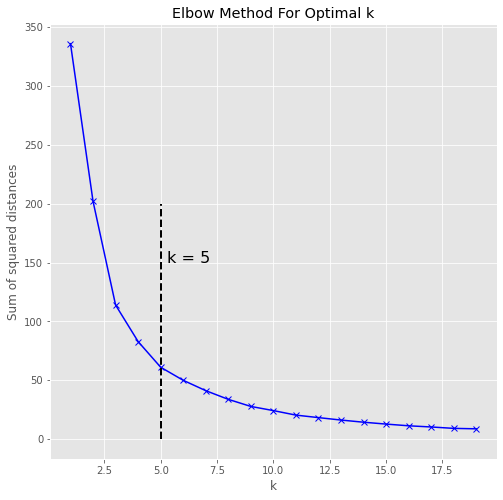

In [52]:
plt.figure(figsize=(8,8))
plt.plot(K, Sum_of_squared_distances, 'bx-')
# draw vertical line from (70,100) to (70, 250)
plt.plot([5, 5], [0, 200], 'k--', lw=2)
plt.text(5.3,150,'k = 5',fontsize=16)
plt.xlabel('k')
plt.ylabel('Sum of squared distances')
plt.title('Elbow Method For Optimal k')
plt.show()

###K-mean clustering

In [54]:
# set number of clusters
kclusters = 5
grouped_clustering =  df_province[['sub_district_id','rest_density_zscore' ,'pop_density_zscore']]
grouped_clustering.set_index('sub_district_id',inplace=True)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([2, 2, 2, 2, 2, 2, 2, 4, 4, 2], dtype=int32)

In [55]:
#df_province.drop('Cluster Labels (K-mean)',axis=1,inplace=True)
df_cluster = df_province
df_cluster.insert(0, 'Cluster Labels (K-mean)', kmeans.labels_)
df_cluster.head()

,Cluster Labels (K-mean),sub_district_id,sub_district_th,sub_district_eng,district_id,district_th,district_eng,latitude,longitude,pop_density,restaurant_count,rest_density,1st Most Restaurant Category,pop_density_zscore,rest_density_zscore
0,2,100101,พระบรมมหาราชวัง,Phraborom Maharatchawang,1001,พระนคร,Phra Nakhon,13.751,100.492,111.843548,1.0,0.000001,Thai Restaurant,0.566783,-0.525552
1,2,100102,วังบูรพาภิรมย์,Wang Burapha Phirom,1001,พระนคร,Phra Nakhon,13.744,100.499,111.843548,6.0,0.000008,Asian Restaurant,0.566783,0.259062
2,2,100103,วัดราชบพิธ,Wat Ratchabophit,1001,พระนคร,Phra Nakhon,13.750,100.499,111.843548,2.0,0.000003,Thai Restaurant,0.566783,-0.368629
3,2,100104,สำราญราษฎร์,Samran Rat,1001,พระนคร,Phra Nakhon,13.751,100.503,111.843548,1.0,0.000001,Thai Restaurant,0.566783,-0.525552
4,2,100105,ศาลเจ้าพ่อเสือ,San Chaopho Suea,1001,พระนคร,Phra Nakhon,13.754,100.497,111.843548,2.0,0.000003,Asian Restaurant,0.566783,-0.368629


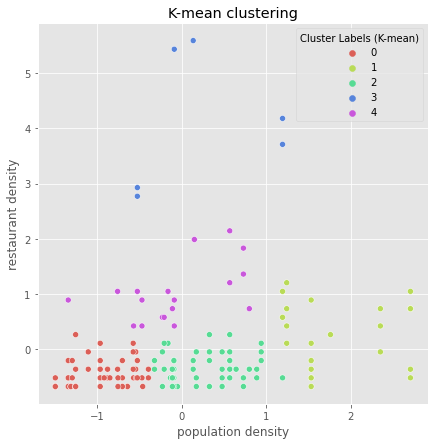

In [57]:
plt.figure(figsize=(7,7))
sns.scatterplot(x='pop_density_zscore',y='rest_density_zscore',hue='Cluster Labels (K-mean)',
                palette=sns.color_palette("hls",5),data=df_province, legend="full")
plt.title('K-mean clustering')
plt.xlabel('population density')
plt.ylabel('restaurant density')
plt.show()

###Mean-shift clustering

In [58]:
grouped_clustering =  df_province[['sub_district_id','rest_density_zscore' ,'pop_density_zscore']]
grouped_clustering.set_index('sub_district_id',inplace=True)

In [59]:
bandwidth = estimate_bandwidth(grouped_clustering, quantile=0.2, n_samples=170)
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True)
ms.fit(grouped_clustering)
labels = ms.labels_
cluster_centers = ms.cluster_centers_

labels_unique = np.unique(labels)
n_clusters_ = len(labels_unique)

print("number of estimated clusters : %d" % n_clusters_)

number of estimated clusters : 6


In [60]:
df_cluster = df_province
df_cluster.insert(0, 'Cluster Labels (Mean-shift)',ms.labels_)
df_cluster.head()

,Cluster Labels (Mean-shift),Cluster Labels (K-mean),sub_district_id,sub_district_th,sub_district_eng,district_id,district_th,district_eng,latitude,longitude,pop_density,restaurant_count,rest_density,1st Most Restaurant Category,pop_density_zscore,rest_density_zscore
0,0,2,100101,พระบรมมหาราชวัง,Phraborom Maharatchawang,1001,พระนคร,Phra Nakhon,13.751,100.492,111.843548,1.0,0.000001,Thai Restaurant,0.566783,-0.525552
1,0,2,100102,วังบูรพาภิรมย์,Wang Burapha Phirom,1001,พระนคร,Phra Nakhon,13.744,100.499,111.843548,6.0,0.000008,Asian Restaurant,0.566783,0.259062
2,0,2,100103,วัดราชบพิธ,Wat Ratchabophit,1001,พระนคร,Phra Nakhon,13.750,100.499,111.843548,2.0,0.000003,Thai Restaurant,0.566783,-0.368629
3,0,2,100104,สำราญราษฎร์,Samran Rat,1001,พระนคร,Phra Nakhon,13.751,100.503,111.843548,1.0,0.000001,Thai Restaurant,0.566783,-0.525552
4,0,2,100105,ศาลเจ้าพ่อเสือ,San Chaopho Suea,1001,พระนคร,Phra Nakhon,13.754,100.497,111.843548,2.0,0.000003,Asian Restaurant,0.566783,-0.368629


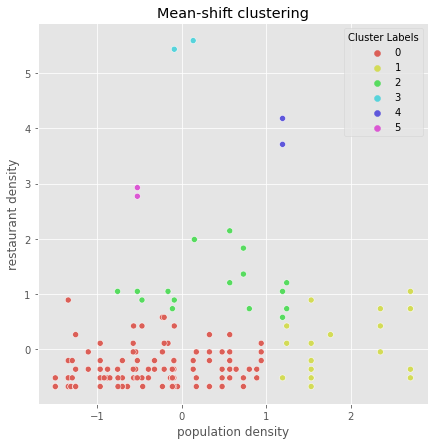

In [61]:
plt.figure(figsize=(7,7))
sns.scatterplot(x='pop_density_zscore',y='rest_density_zscore',hue='Cluster Labels (Mean-shift)',
                palette=sns.color_palette("hls",6),data=df_province, legend="full")
plt.title('Mean-shift clustering')
plt.xlabel('population density')
plt.ylabel('restaurant density')
plt.legend(loc='upper right',title='Cluster Labels')
plt.show()

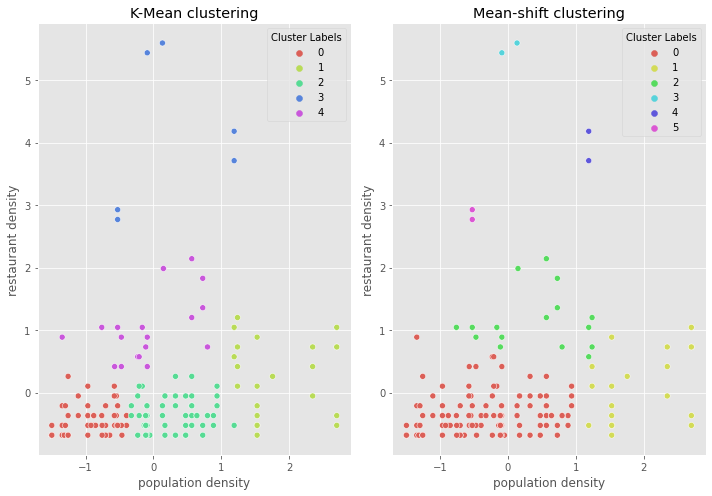

In [62]:
f, axs = plt.subplots(1, 2, figsize=(10, 7), gridspec_kw=dict(width_ratios=[5, 5]))

# Subplot 1: Box plot
sns.scatterplot(x='pop_density_zscore',y='rest_density_zscore',hue='Cluster Labels (Mean-shift)',
                palette=sns.color_palette("hls",6),data=df_province,
               legend="full",ax=axs[1])
axs[1].set_ylabel('restaurant density')
axs[1].set_xlabel('population density')
axs[1].set_title('Mean-shift clustering')
axs[1].legend(loc='upper right',title='Cluster Labels')

# Subplot 2: Line plot
sns.scatterplot(x='pop_density_zscore',y='rest_density_zscore',hue='Cluster Labels (K-mean)',
                palette=sns.color_palette("hls",5),data=df_province,
               legend="full",ax=axs[0])
axs[0].set_ylabel('restaurant density')
axs[0].set_xlabel('population density')
axs[0].set_title('K-Mean clustering')
axs[0].legend(loc='upper right',title='Cluster Labels')
f.tight_layout()

#4. Results

##Visualize the resulting clusters

In [63]:
sub_district_geojson = sub_district_geojson.merge(df_province[['sub_district_id','Cluster Labels (Mean-shift)','Cluster Labels (K-mean)','1st Most Restaurant Category']],left_on='sub_district_id',right_on='sub_district_id',how='left')


In [64]:
# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

###K-Mean Clustering Choropleth Map


In [67]:
sub_bangkok_geo = sub_district_geojson#'bangkok_sub_district.geojson' # geojson file

# create a plain province map
kmean_map = folium.Map(location=[latitude, longitude], zoom_start=13)

#use different map tiles (OpenStreetMap, CartoDB, Stamen, Mapbox...) 
folium.TileLayer('OpenStreetMap',name="Light Map",control=False).add_to(kmean_map)

# generate choropleth map using the population of each district
kmean_map.choropleth(    
    geo_data=sub_bangkok_geo,
    data=df_province,
    columns=['sub_district_id','pop_density'],
    key_on='feature.properties.sub_district_id',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='population per square meter of each sub-district'
)

# set color scheme for the clusters
x = np.arange(5)
ys = [i + x + (i*x)**2 for i in range(5)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(df_province['latitude'], df_province['longitude'], df_province['sub_district_eng'], df_province['Cluster Labels (K-mean)']):
    label = folium.Popup(str(poi) + ' Cluster Labels (K-mean)' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(kmean_map)


style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
BKK = folium.features.GeoJson(
    sub_district_geojson,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['sub_district_eng','rest_density','pop_density','Cluster Labels (K-mean)','1st Most Restaurant Category'],
        aliases=['Sub-district name: ','Restaurant per square meter : ','Peoper per square meter : ','Cluster Label (K-mean) :','The most common category of restaurants :'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
kmean_map.add_child(BKK)
kmean_map.keep_in_front(BKK)
folium.LayerControl().add_to(kmean_map)
kmean_map
       

/usr/local/lib/python3.7/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


###Mean-Shift Clustering Choropleth Map

In [66]:
sub_bangkok_geo = sub_district_geojson#'bangkok_sub_district.geojson' # geojson file

# create a plain province map
sub_bangkok_map = folium.Map(location=[latitude, longitude], zoom_start=13)

#use different map tiles (OpenStreetMap, CartoDB, Stamen, Mapbox...) 
folium.TileLayer('OpenStreetMap',name="Light Map",control=False).add_to(sub_bangkok_map)

# generate choropleth map using the population of each district
sub_bangkok_map.choropleth(    
    geo_data=sub_bangkok_geo,
    data=df_province,
    columns=['sub_district_id','pop_density'],
    key_on='feature.properties.sub_district_id',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='population per square meter of each sub-district'
)

# set color scheme for the clusters
x = np.arange(6)
ys = [i + x + (i*x)**2 for i in range(6)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(df_province['latitude'], df_province['longitude'], df_province['sub_district_eng'], df_province['Cluster Labels (Mean-shift)']):
    label = folium.Popup(str(poi) + ' Cluster Labels (Mean-shift)' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(sub_bangkok_map)



style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
BKK = folium.features.GeoJson(
    sub_district_geojson,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['sub_district_eng','rest_density','pop_density','Cluster Labels (Mean-shift)','1st Most Restaurant Category'],
        aliases=['Sub-district name: ','Restaurant per square meter : ','Peoper per square meter : ','Cluster Label (Mean-shift)','The most common category of restaurants :'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
sub_bangkok_map.add_child(BKK)
sub_bangkok_map.keep_in_front(BKK)
folium.LayerControl().add_to(sub_bangkok_map)
sub_bangkok_map
       

/usr/local/lib/python3.7/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


#5.	Discussion
From a problem is clustering sub-district in Bangkok and there are two solutions I have selected: the first method is K-Mean clustering, which is the most popular method. In order to train the model with my dataset, which is a small dataset (170 samples) and it is difficult to select the suitable k. So, I chose the second method which is Mean-Shift clustering, which is appropriate for a small dataset and does not set the number of clusters.

However, the model imported dataset has only 2 features, which are very minimal. So, in order to improve this project in the future, I plan to add more analytical features.


#6.	Conclusion
In this study, I am trying to cluster the sub-district in Bangkok as an informative decision for investors to build a business, especially a restaurant business. It considers two features: population density and restaurant density. However, the restaurant data that we analyzed is taken from the Foursquare API, which only retrieves the restaurants that are online on the Foursquare platform, so there are many offline restaurants that have not been considered. This is an important part that we must continue to improve. However, in this study, it is still beneficial to the creators and those who are interested in bringing this concept to the next level.


#7.	Reference

* [1] https://en.wikipedia.org/wiki/Bangkok
*	[2] Population data - https://data.go.th/dataset
* [3] Thailand administrative region - https://data.humdata.org
* [4] Sub-district location coordinates - https://data.go.th/dataset
* [5] Foursquare API - https://foursquare.com
* [6] Mean-Shift - https://scikit-learn.org/
